In [1]:
!pip install tensorflow_ranking tensorflow_probability tensorflow_addons

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 150.4/150.4 kB 18.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.7/6.7 MB 83.4 MB/s eta 0:00:00:00:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 79.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 69.0 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.0/153.0 kB 37.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 588.3/588.3 MB 3.8 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 79.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.0/6.0 MB 79.5 MB/s eta 0:00:00:00:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 439.2/439.2 kB 58.8 MB/s eta 0:00:00
  Attempting uninstall: flatbuffers
    Found existing installation: flatbuffers 1.12
    Uninstalling flatbuffers-1.12:
      Successfully uninstalled flatbuffers-1.12
  Attempting uninstall: tensorflow-estimator
    Found existing inst

In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

import tensorflow as tf
import tensorflow_ranking as tfr
import tensorflow_probability as tfp
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Flatten, LSTM, Permute, Conv1D, MaxPooling1D, Conv2D, MaxPooling2D, Reshape, Dropout
from tensorflow.keras.optimizers import Adam

from keras.regularizers import l2, l1


from sklearn.decomposition import PCA
from sklearn.utils import class_weight
from sklearn.metrics import f1_score
import sklearn

import pickle

from featurize import featurize
from visualise import *

from scaler import CustomScaler

from VAE_stats import VAE_stats

2023-02-14 15:04:30.831906: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-14 15:04:31.671291: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-02-14 15:04:31.671382: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-02-14 15:04:31.671392: W tensorfl

In [2]:
tf.get_logger().setLevel('ERROR')

device_name = tf.test.gpu_device_name()

file_name = "raw_with_maps" # or offsets_2

x_data = np.load(f"data/processed/x_{file_name}_filtered.npy")[:,:,[0,1,2,4,5,6]]

#from featurize import filter as _filter, ORDER, CUTOFF, FILTER_INDICES
#x_data = _filter(x_data, FILTER_INDICES, ORDER, CUTOFF)

y_user = np.load(f"data/processed/y_user_{file_name}.npy")
y_intent = np.load(f"data/processed/y_intent_{file_name}.npy").astype(int)
y_gesture = np.load(f"data/processed/y_gesture_type_{file_name}.npy")

train_gesture_map = np.load(f"data/processed/train_gesture_map_{file_name}.npy").astype(int)
test_gesture_map = np.load(f"data/processed/test_gesture_map_{file_name}.npy").astype(int)

###


_map = (test_gesture_map == 1) #& ((y_user.argmax(axis=1) >= 11))

user_x = x_data[_map]
user_y = y_user.argmax(axis=1)[_map]

def show_visuals(vae, mode="train"):
    if mode == "train":
        _map = (train_gesture_map == 1) #& ((y_user.argmax(axis=1) >= 11))
    else:
        _map = (test_gesture_map == 1)
    user_x = x_data[_map]
    user_y = y_user.argmax(axis=1)[_map]
    
    latent_space_means, latent_space_stds, latent_space = vae.encoder(vae.scaler.transform(x_data[:10]))

    plt.scatter(latent_space_means[:,0], latent_space_means[:,1], c = range(10), label="means")
    plt.scatter(latent_space[:,0], latent_space[:,1], label="sampled", c = range(10), s=10)

    plt.legend()
    
    plot_label_clusters(vae, vae.scaler.transform(user_x), user_y)
    visualise(vae, vae.scaler.transform(user_x), user_y, 10)
    plot_reconstructed_curves(vae, vae.scaler.transform(user_x), channel=0)


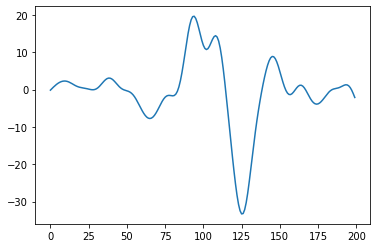

In [3]:
plt.plot(x_data[0,:,4])

(54,)
75/75 [==============================] - 1s 5ms/step


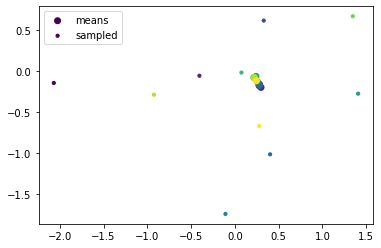

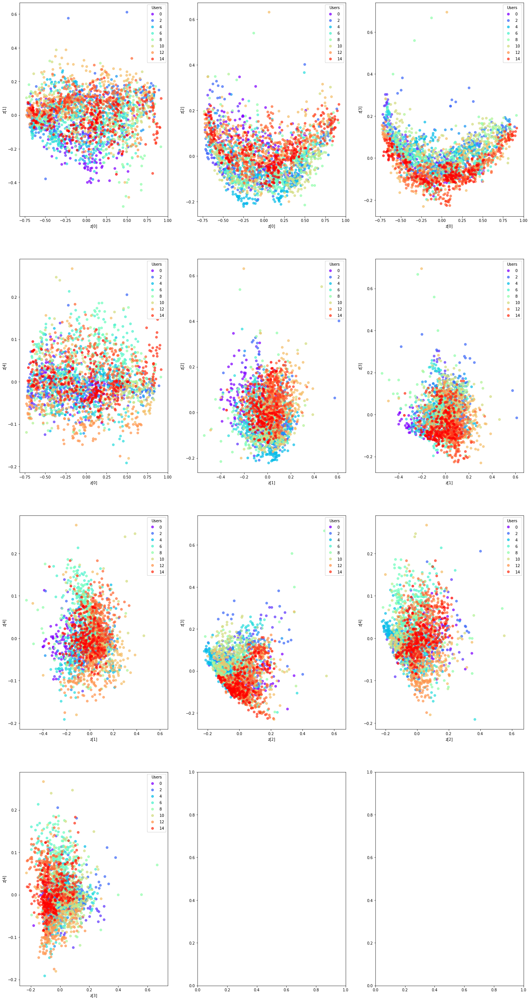

75/75 [==============================] - 0s 4ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


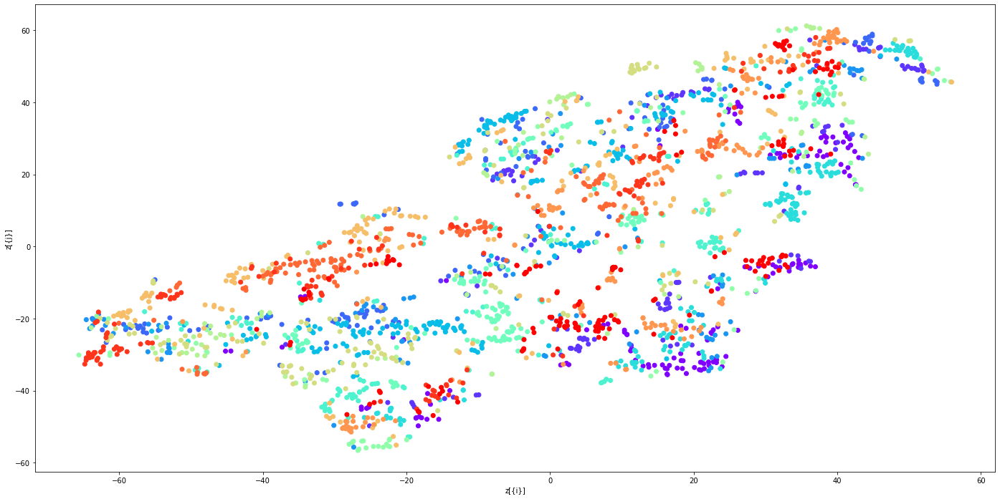

1/1 [==============================] - 0s 23ms/step


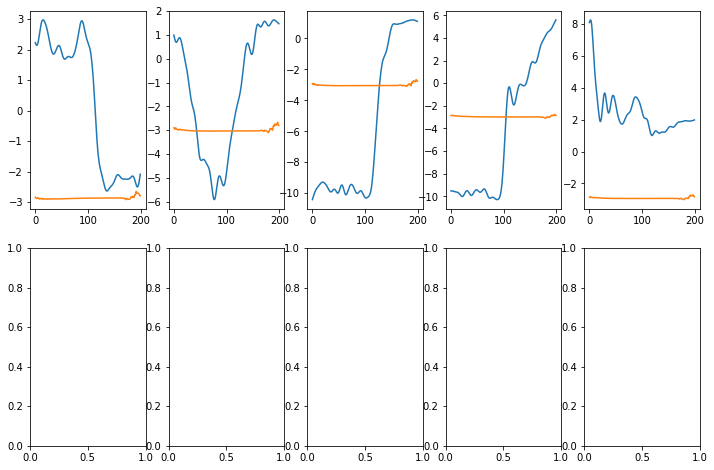

34/34 [==============================] - 0s 4ms/step


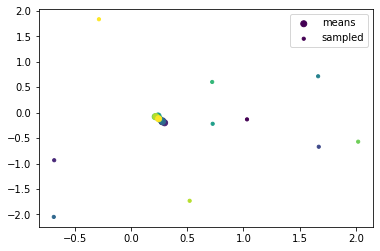

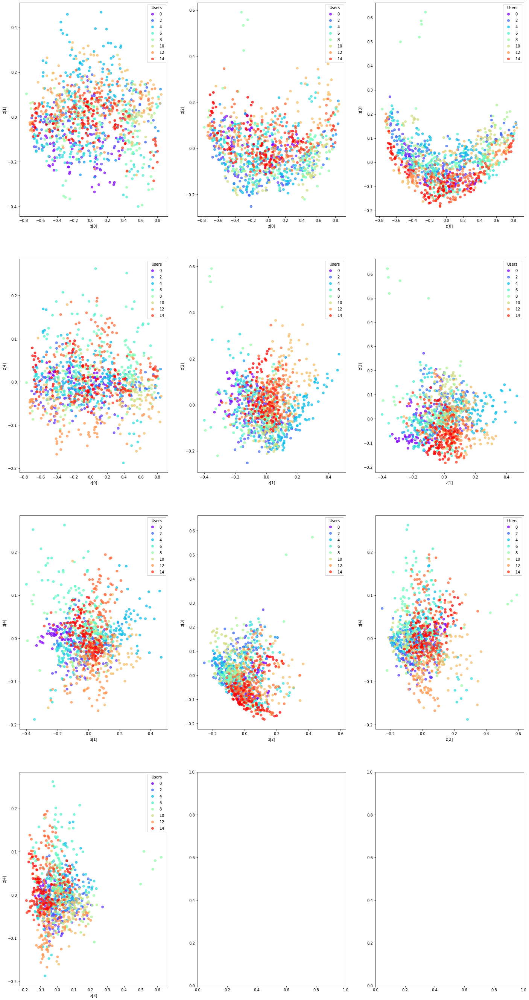

34/34 [==============================] - 0s 4ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


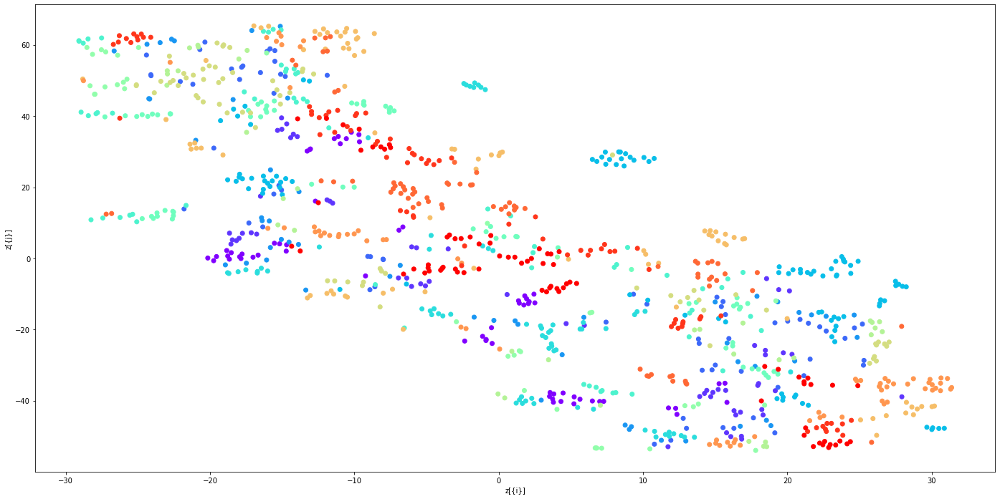

1/1 [==============================] - 0s 21ms/step


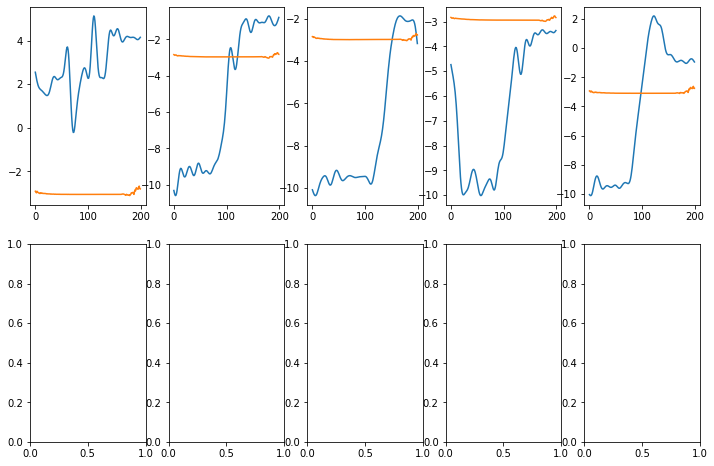

Fitting basic
Epoch 1/15
260/260 [==============================] - 24s 59ms/step - loss: 0.3772 - reconstruction_loss: 0.3033 - feature_loss: 3.0421 - auth_loss: -0.1573 - kl_loss: 34.2714 - stat_loss: 0.2820
Epoch 2/15
260/260 [==============================] - 15s 59ms/step - loss: 0.2897 - reconstruction_loss: 0.2626 - feature_loss: 2.9966 - auth_loss: -0.1427 - kl_loss: 46.8999 - stat_loss: 0.2161
Epoch 3/15
260/260 [==============================] - 15s 59ms/step - loss: 0.2715 - reconstruction_loss: 0.2387 - feature_loss: 2.9980 - auth_loss: -0.1335 - kl_loss: 54.9554 - stat_loss: 0.2037
Epoch 4/15
260/260 [==============================] - 15s 58ms/step - loss: 0.2244 - reconstruction_loss: 0.1871 - feature_loss: 2.9925 - auth_loss: -0.1300 - kl_loss: 63.5308 - stat_loss: 0.1965
Epoch 5/15
260/260 [==============================] - 15s 60ms/step - loss: 0.1911 - reconstruction_loss: 0.1661 - feature_loss: 2.9892 - auth_loss: -0.1272 - kl_loss: 67.6031 - stat_loss: 0.1905
Epoch 

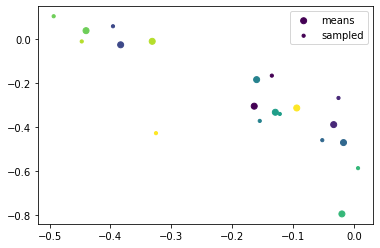

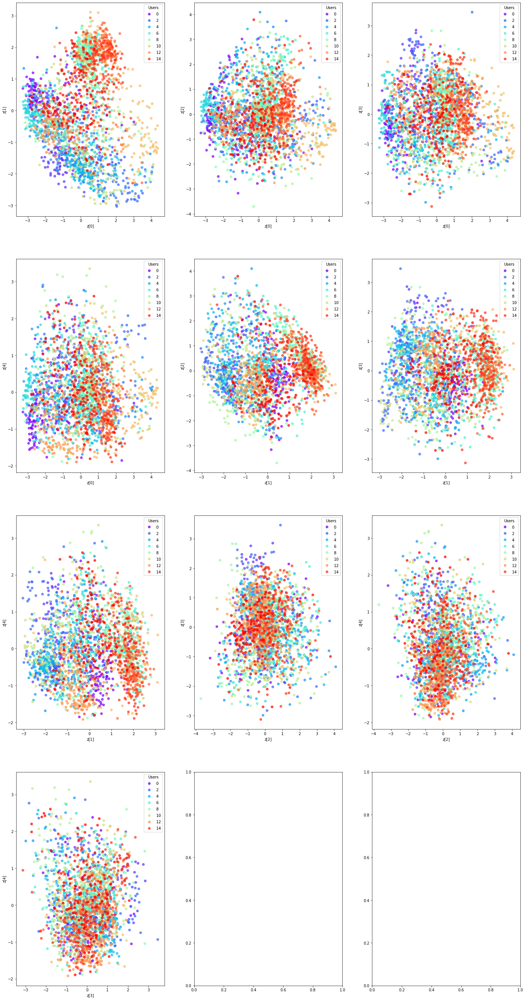

75/75 [==============================] - 0s 4ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


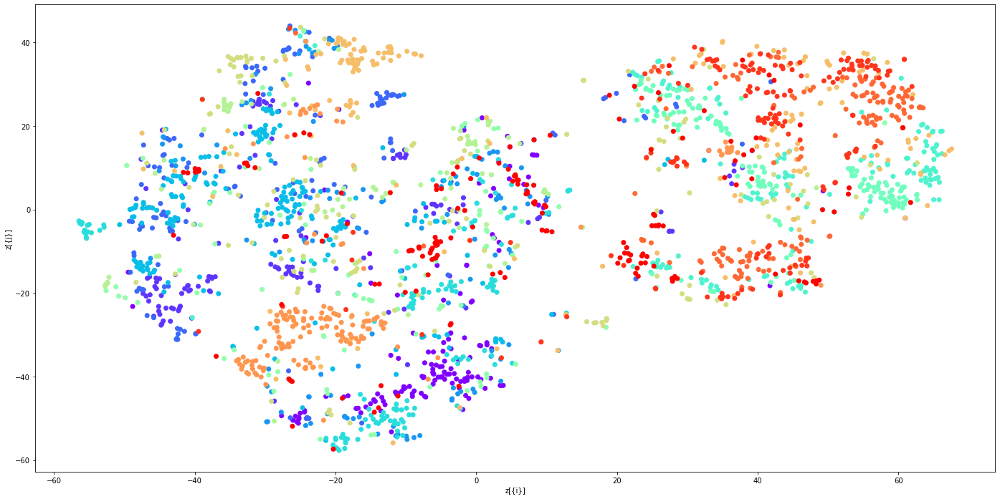

1/1 [==============================] - 0s 22ms/step


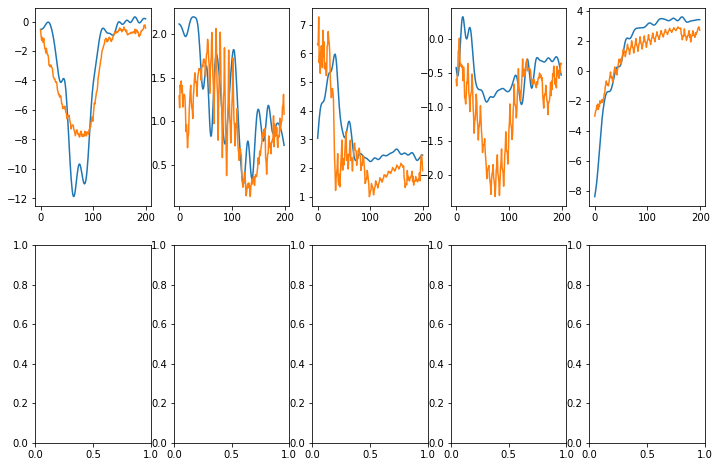

34/34 [==============================] - 0s 4ms/step


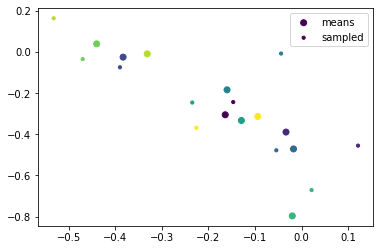

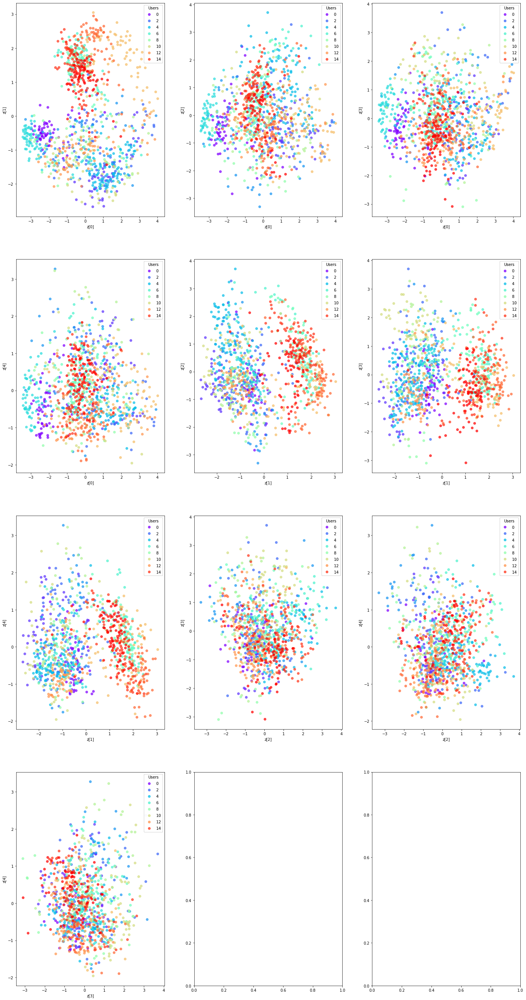

34/34 [==============================] - 0s 5ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


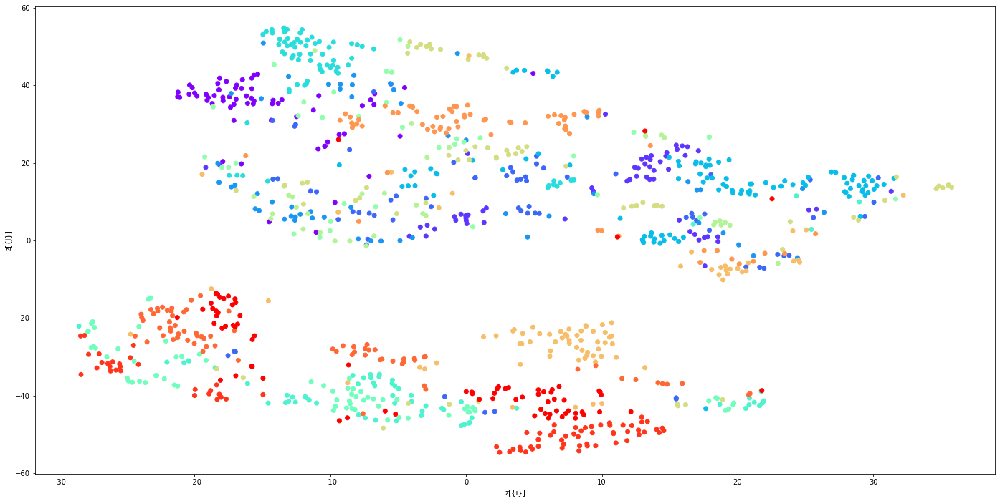

1/1 [==============================] - 0s 21ms/step


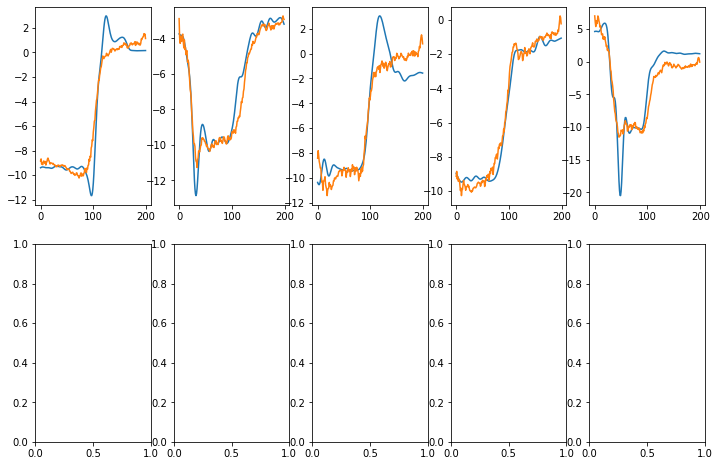

Fitting specific
Epoch 1/200
19/19 [==============================] - 11s 59ms/step - loss: 0.6648 - reconstruction_loss: 0.0798 - feature_loss: 2.8255 - auth_loss: -0.1194 - kl_loss: 93.3712 - stat_loss: 0.1195
Epoch 2/200
19/19 [==============================] - 1s 60ms/step - loss: 0.6537 - reconstruction_loss: 0.0766 - feature_loss: 2.7945 - auth_loss: -0.1202 - kl_loss: 95.0718 - stat_loss: 0.1178
Epoch 3/200
19/19 [==============================] - 1s 60ms/step - loss: 0.6443 - reconstruction_loss: 0.0752 - feature_loss: 2.7784 - auth_loss: -0.1211 - kl_loss: 96.7350 - stat_loss: 0.1165
Epoch 4/200
19/19 [==============================] - 1s 64ms/step - loss: 0.6396 - reconstruction_loss: 0.0743 - feature_loss: 2.7630 - auth_loss: -0.1221 - kl_loss: 97.4489 - stat_loss: 0.1158
Epoch 5/200
19/19 [==============================] - 1s 64ms/step - loss: 0.6389 - reconstruction_loss: 0.0735 - feature_loss: 2.7482 - auth_loss: -0.1237 - kl_loss: 98.5613 - stat_loss: 0.1157
Epoch 6/200


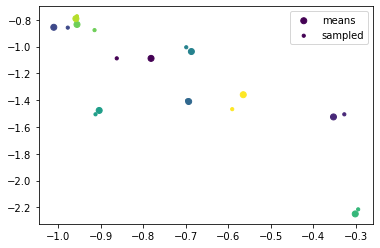

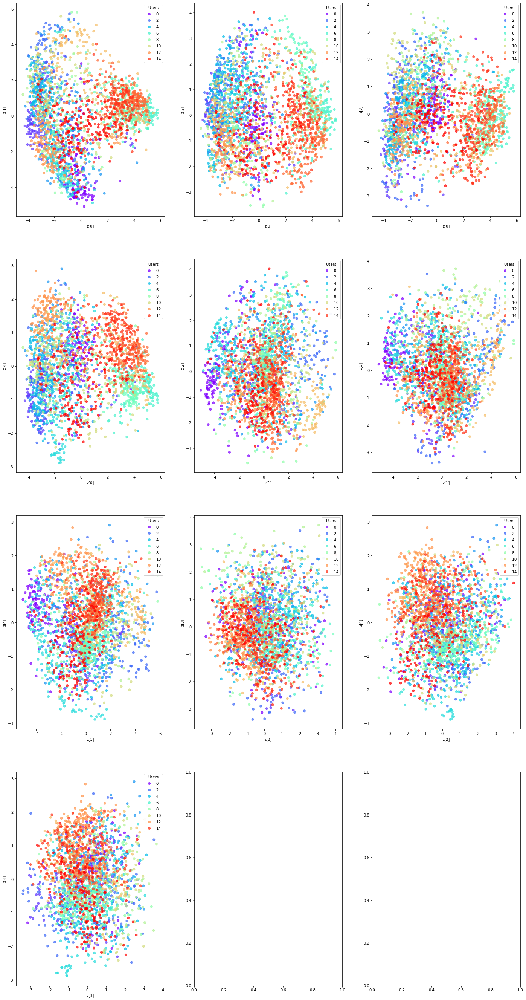

75/75 [==============================] - 0s 5ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


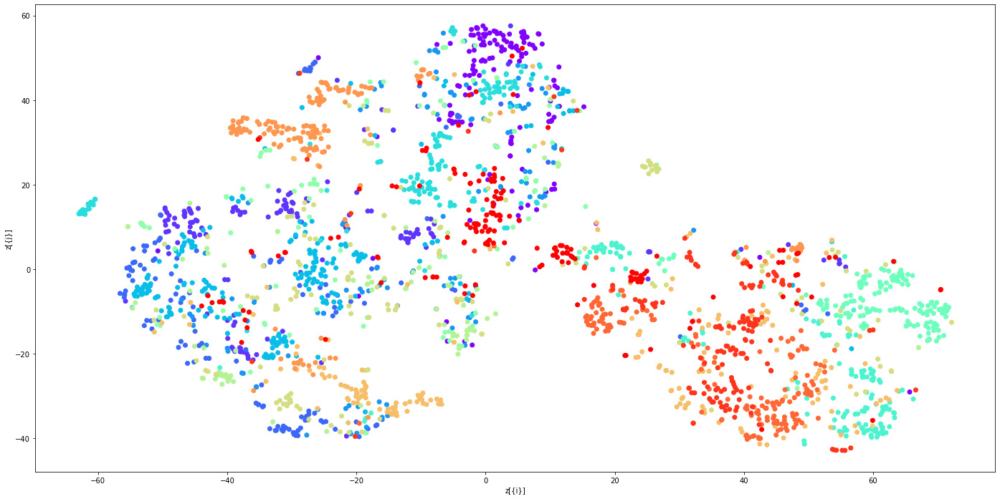

1/1 [==============================] - 0s 25ms/step


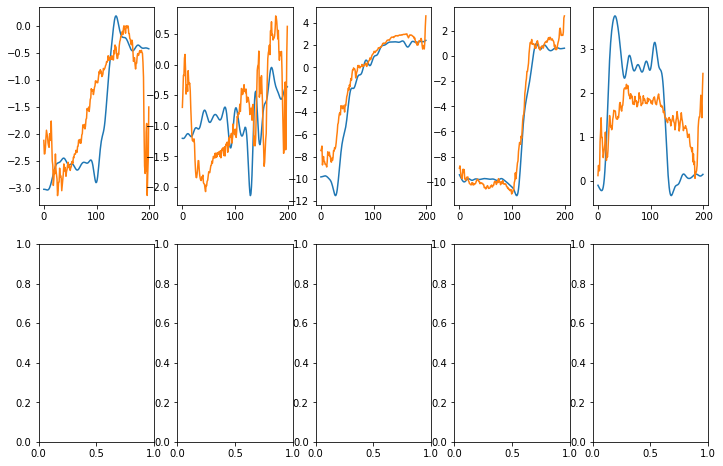

Keras weights file (<HDF5 file "variables.h5" (mode r+)>) saving:
...layers
......concatenate
.........vars
......conv1d
.........vars
............0
............1
......conv1d_1
.........vars
............0
............1
......conv1d_10
.........vars
............0
............1
......conv1d_11
.........vars
............0
............1
......conv1d_2
.........vars
............0
............1
......conv1d_3
.........vars
............0
............1
......conv1d_4
.........vars
............0
............1
......conv1d_5
.........vars
............0
............1
......conv1d_6
.........vars
............0
............1
......conv1d_7
.........vars
............0
............1
......conv1d_8
.........vars
............0
............1
......conv1d_9
.........vars
............0
............1
......dense
.........vars
............0
............1
......dense_1
.........vars
............0
............1
......input_layer
.........vars
......lstm
.........cell
............vars
...............0
.......

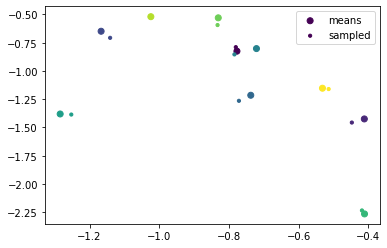

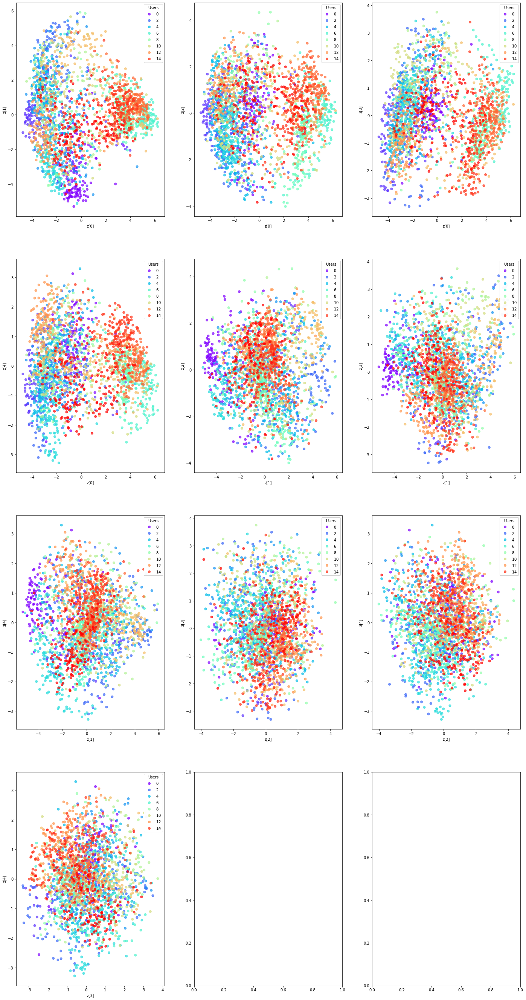

75/75 [==============================] - 0s 4ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


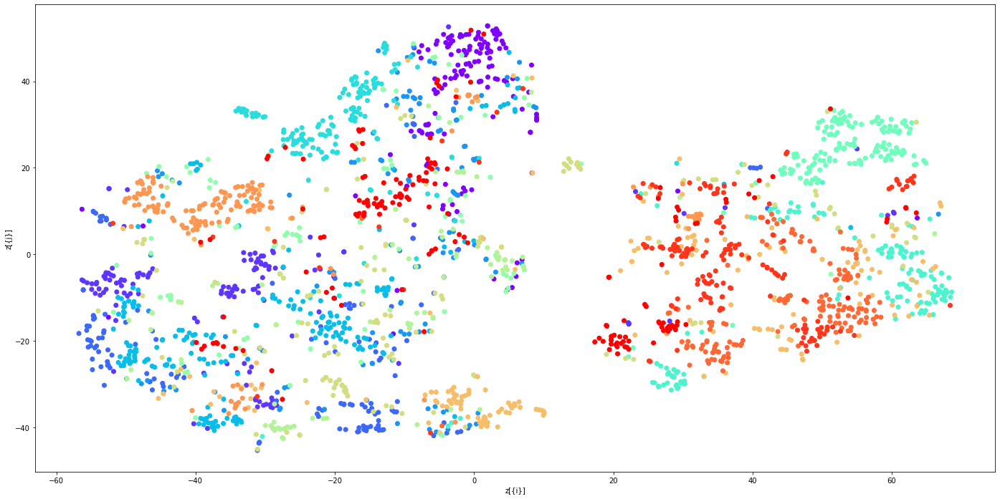

1/1 [==============================] - 0s 20ms/step


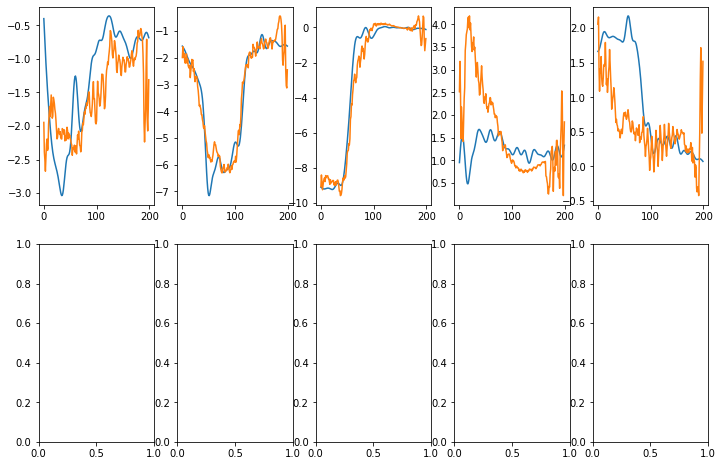

Keras weights file (<HDF5 file "variables.h5" (mode r+)>) saving:
...layers
......concatenate
.........vars
......conv1d
.........vars
............0
............1
......conv1d_1
.........vars
............0
............1
......conv1d_10
.........vars
............0
............1
......conv1d_11
.........vars
............0
............1
......conv1d_2
.........vars
............0
............1
......conv1d_3
.........vars
............0
............1
......conv1d_4
.........vars
............0
............1
......conv1d_5
.........vars
............0
............1
......conv1d_6
.........vars
............0
............1
......conv1d_7
.........vars
............0
............1
......conv1d_8
.........vars
............0
............1
......conv1d_9
.........vars
............0
............1
......dense
.........vars
............0
............1
......dense_1
.........vars
............0
............1
......input_layer
.........vars
......lstm
.........cell
............vars
...............0
.......

KeyboardInterrupt: 

In [6]:
for latent_dim in [50]: # , 30, 10, 100]: # 500, 50, 40, 30, 20, 10

#latent_dim = 100
    
    vae = VAE_stats(latent_dim)
    vae.fit_scaler(x_data[(y_intent==0)])
    vae.auth_on = False
    
    show_visuals(vae, "train")
    show_visuals(vae, "test")

    initial_map = (train_gesture_map==1) | (y_intent == 0)
    train_data = vae.scaler.transform(x_data[initial_map])

    print("Fitting basic")

    vae.beta = 1e-4
    vae.compile(Adam())
    history_1 = vae.fit(train_data, y_user[initial_map], epochs=15, batch_size=128, verbose=1)
    vae.save_model(f"all_users", f"vae_stats_basic_reconstruction_reduced_{latent_dim}")
    
    
    specific_map = (train_gesture_map==1) 
    vae = VAE_stats(latent_dim)
    vae.load_model(f"all_users", f"vae_stats_basic_reconstruction_reduced_{latent_dim}")
    vae.fit_scaler(x_data[(y_intent==0)])

    show_visuals(vae, "train")
    show_visuals(vae, "test")
    
    beta = 1e-4
    vae.alpha = 0.2
    vae.beta = beta
    vae.gamma = 0.25
    vae.delta = 0.2
    vae.auth_on = True

    vae.compile(Adam(learning_rate = 1e-4))

    epochs = 5
    train_data = vae.scaler.transform(x_data[specific_map])
    
    
    for i in range(10):
        print("Fitting specific")

        vae.fit(train_data, y_user[specific_map], epochs=200, batch_size=128, verbose=1)

        #show_visuals(vae, "train")
        #show_visuals(vae, "test")
        vae.save_model(f"all_users", f"vae_stats_specific_reduced_{latent_dim}")
    """
    beta = 1e-2
    vae.beta = beta
    vae.alpha = 0.5
    vae.auth_on = True
    print("Fitting specific - higher auth")
    
    vae.fit(train_data, y_user[specific_map], epochs=1000, batch_size=128, verbose=1)
    
    show_visuals(vae)
    """
    
    

10
Keras model archive loading:
File Name                                             Modified             Size
metadata.json                                  2023-02-14 15:08:56           64
config.json                                    2023-02-14 15:08:56        15904
variables.h5                                   2023-02-14 15:08:56      1367872
Keras weights file (<HDF5 file "variables.h5" (mode r)>) loading:
...layers
......concatenate
.........vars
......conv1d
.........vars
............0
............1
......conv1d_1
.........vars
............0
............1
......conv1d_10
.........vars
............0
............1
......conv1d_11
.........vars
............0
............1
......conv1d_2
.........vars
............0
............1
......conv1d_3
.........vars
............0
............1
......conv1d_4
.........vars
............0
............1
......conv1d_5
.........vars
............0
............1
......conv1d_6
.........vars
............0
............1
......conv1d_7
.........var

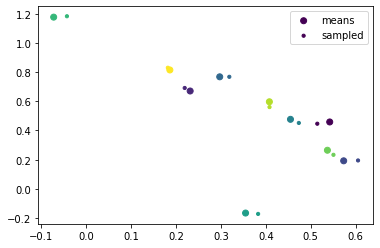

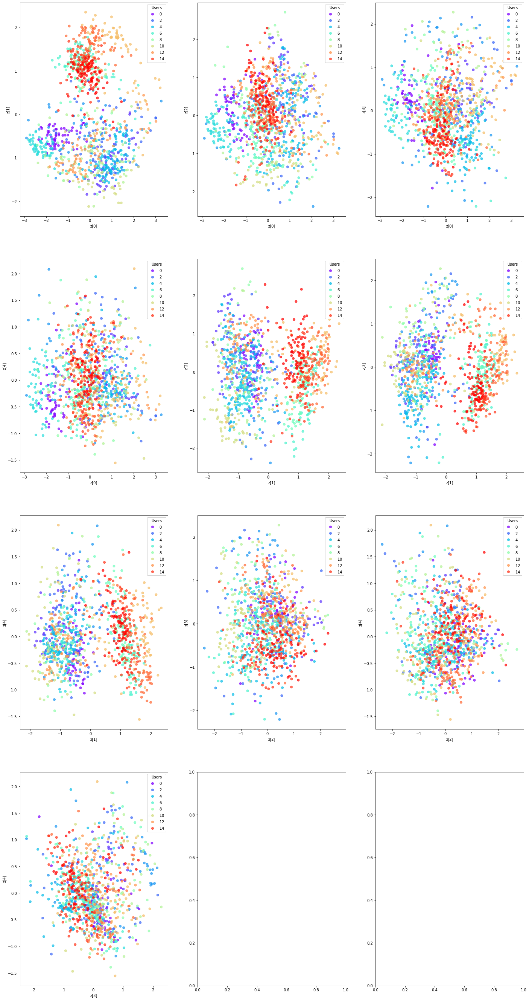

34/34 [==============================] - 0s 3ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


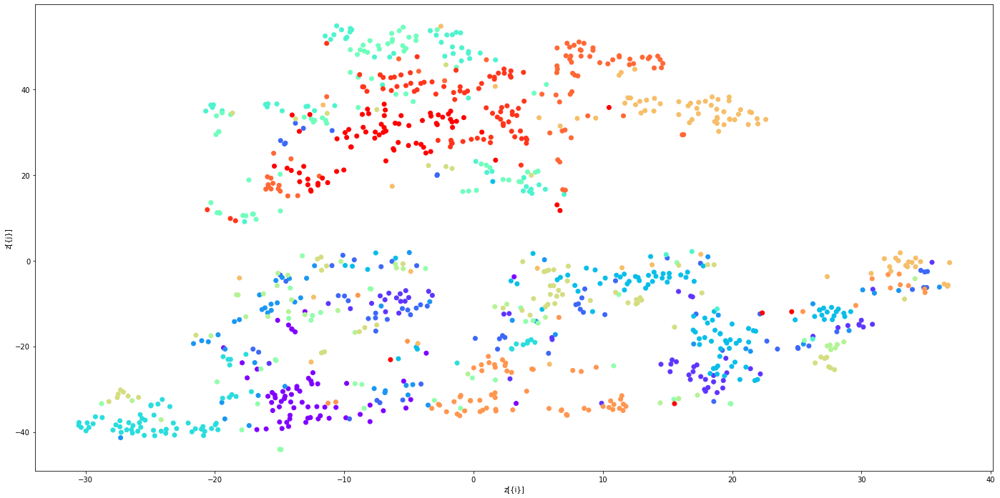

1/1 [==============================] - 0s 19ms/step


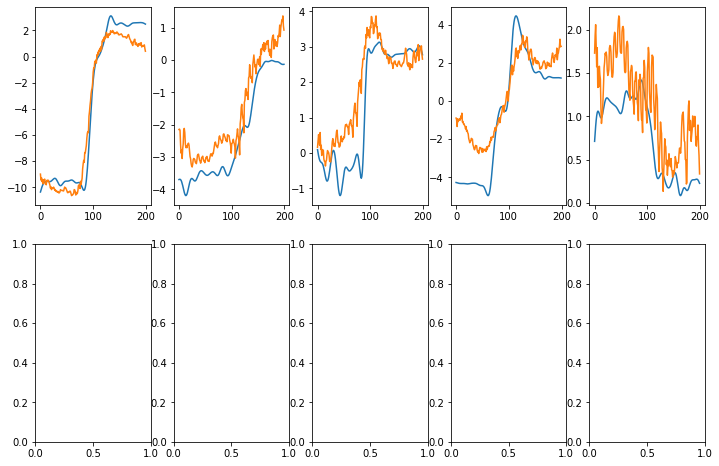

40
Keras model archive loading:
File Name                                             Modified             Size
metadata.json                                  2023-02-14 15:42:06           64
config.json                                    2023-02-14 15:42:06        16053
variables.h5                                   2023-02-14 15:42:06      1379776
Keras weights file (<HDF5 file "variables.h5" (mode r)>) loading:
...layers
......concatenate
.........vars
......conv1d
.........vars
............0
............1
......conv1d_1
.........vars
............0
............1
......conv1d_10
.........vars
............0
............1
......conv1d_11
.........vars
............0
............1
......conv1d_2
.........vars
............0
............1
......conv1d_3
.........vars
............0
............1
......conv1d_4
.........vars
............0
............1
......conv1d_5
.........vars
............0
............1
......conv1d_6
.........vars
............0
............1
......conv1d_7
.........var

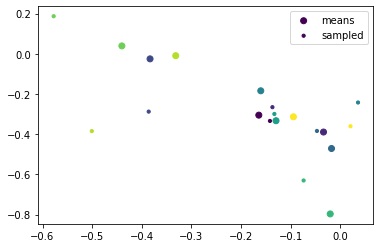

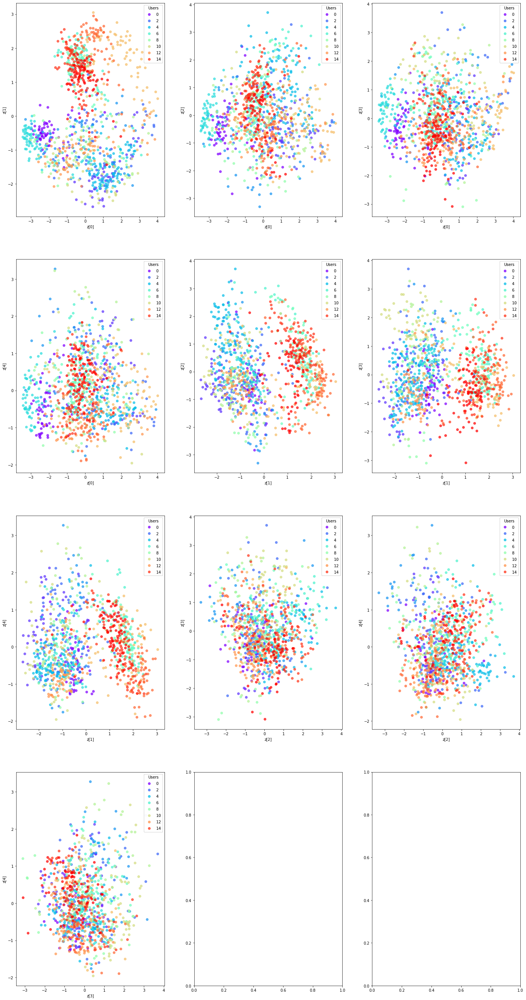

34/34 [==============================] - 0s 3ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


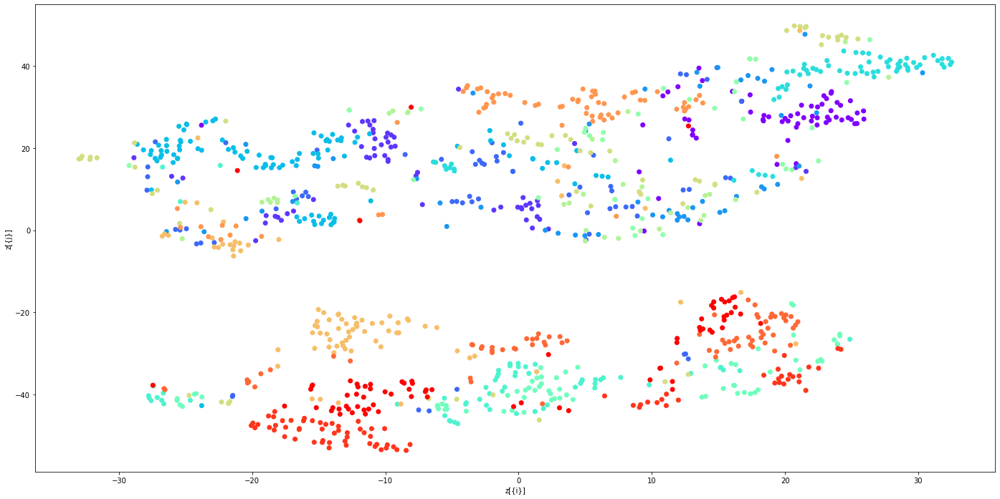

1/1 [==============================] - 0s 21ms/step


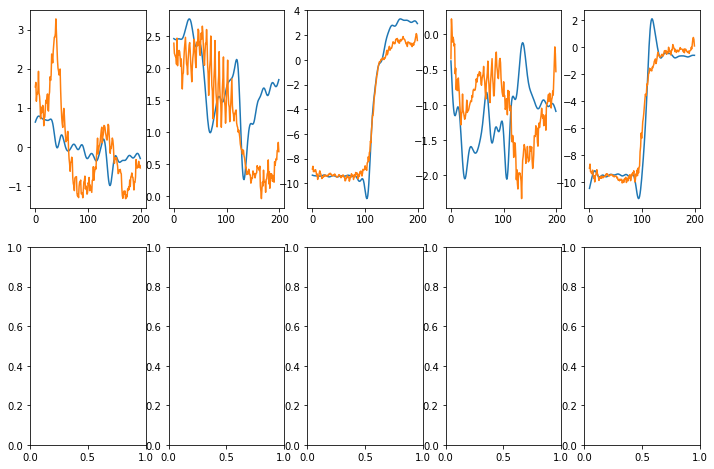

50
Keras model archive loading:
File Name                                             Modified             Size
metadata.json                                  2023-02-14 13:49:28           64
config.json                                    2023-02-14 13:49:28        15904
variables.h5                                   2023-02-14 13:49:28      1383776
Keras weights file (<HDF5 file "variables.h5" (mode r)>) loading:
...layers
......concatenate
.........vars
......conv1d
.........vars
............0
............1
......conv1d_1
.........vars
............0
............1
......conv1d_10
.........vars
............0
............1
......conv1d_11
.........vars
............0
............1
......conv1d_2
.........vars
............0
............1
......conv1d_3
.........vars
............0
............1
......conv1d_4
.........vars
............0
............1
......conv1d_5
.........vars
............0
............1
......conv1d_6
.........vars
............0
............1
......conv1d_7
.........var

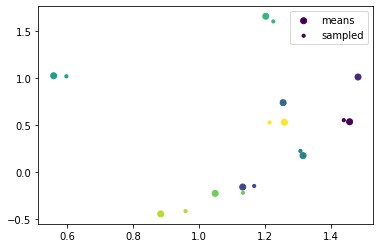

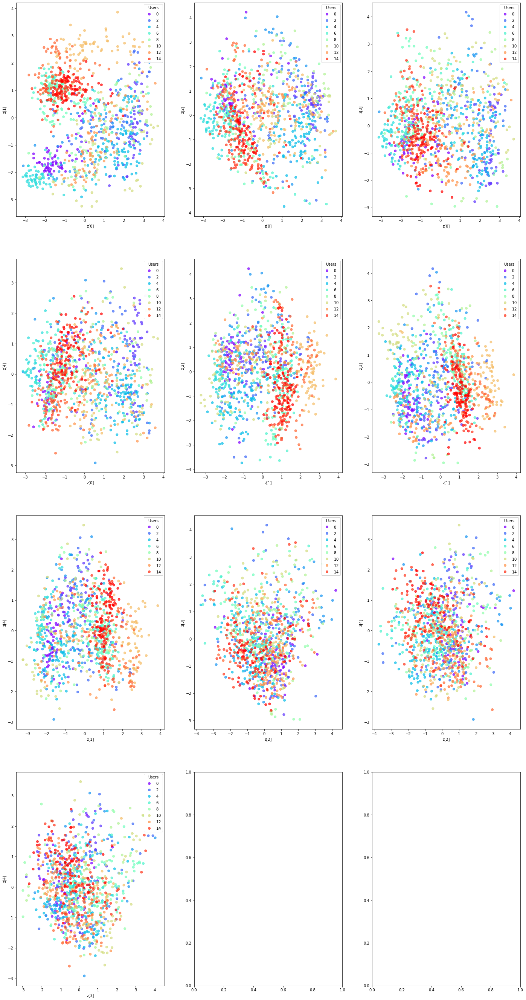

34/34 [==============================] - 0s 4ms/step


/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


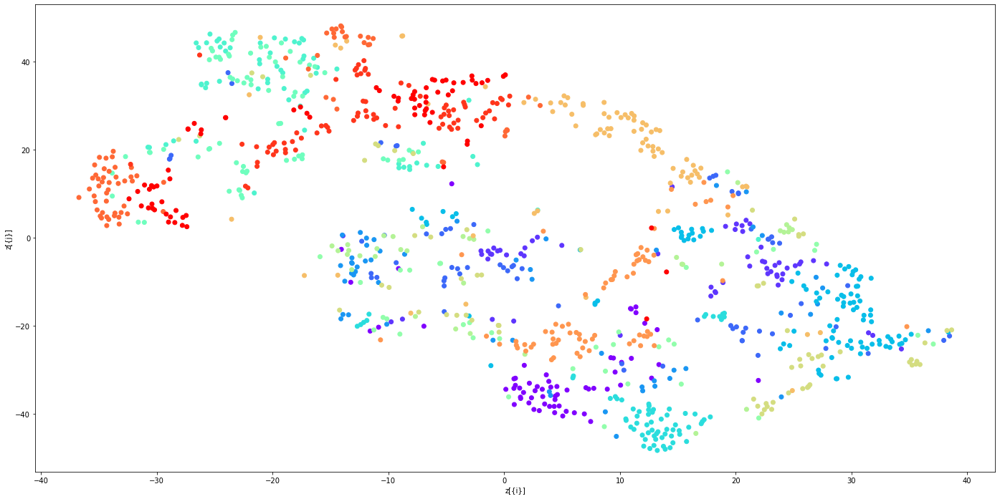

1/1 [==============================] - 0s 20ms/step


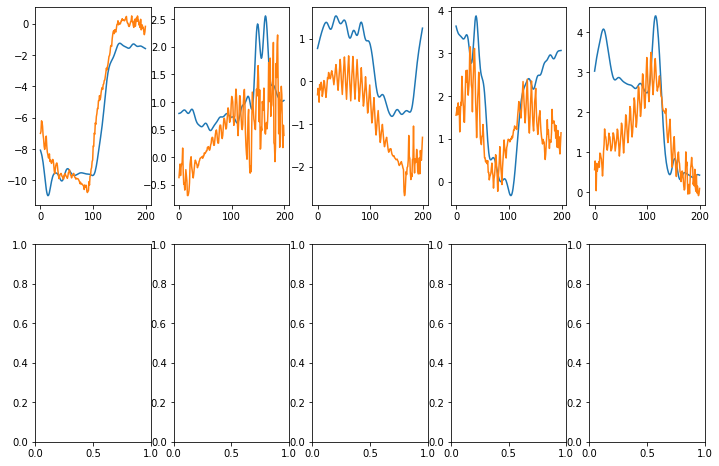

In [9]:
for latent_dim in [10,40,50]:
    print(latent_dim)
    vae = VAE_stats(latent_dim)
    vae.load_model(f"all_users", f"vae_stats_basic_reconstruction_reduced_{latent_dim}")
    show_visuals(vae, "test")

In [ ]:
def feature_max(g_data):
	return tf.math.reduce_max(g_data, axis=1)
 
def feature_min(g_data):
	return tf.math.reduce_min(g_data, axis=1)
 

def feature_mean(g_data):
	return tf.math.reduce_mean(g_data, axis=1)
    
def feature_stdev(g_data):
	return tf.math.reduce_std(g_data, axis=1)

def feature_var(g_data):
	return tf.math.reduce_variance(g_data, axis=1)

def feature_median(g_data):
    return tfp.stats.percentile(g_data, 50.0, interpolation='midpoint', axis=1)

def feature_iqr(g_data):
    return tfp.stats.percentile(g_data, 75.0, interpolation='midpoint', axis=1) - tfp.stats.percentile(g_data, 25.0, interpolation='midpoint', axis=1)

def feature_kurt(g_data):
    std = tf.math.reduce_std(g_data, axis=1)
    diff = tf.math.reduce_mean((g_data - tf.math.reduce_mean(g_data, axis=1, keepdims = True))**4, axis=1)
    return diff / std**4

def feature_skew(g_data):
    std = tf.math.reduce_std(g_data, axis=1)
    diff = tf.math.reduce_mean((g_data - tf.math.reduce_mean(g_data, axis=1, keepdims = True))**3, axis=1)
    return diff / std**3

In [79]:
file_name = "raw_with_maps" # or offsets_2

x_data = np.load(f"data/processed/x_{file_name}_filtered.npy")
y_user = np.load(f"data/processed/y_user_{file_name}.npy")
y_intent = np.load(f"data/processed/y_intent_{file_name}.npy").astype(int)
y_gesture = np.load(f"data/processed/y_gesture_type_{file_name}.npy")

train_gesture_map = np.load(f"data/processed/train_gesture_map_{file_name}.npy").astype(int)

test_gesture_map = np.load(f"data/processed/test_gesture_map_{file_name}.npy").astype(int)


In [80]:
trial_data = x_data[:128]

In [81]:
data = tf.convert_to_tensor(trial_data)

In [82]:
_max = feature_max(data)
_min = feature_min(data)
_mean = feature_mean(data)
_std = feature_stdev(data)
_var = feature_var(data)
_median = feature_median(data)
_iqr = feature_iqr(data)
_kurt = feature_kurt(data)
_skew = feature_skew(data)

features = tf.concat([_max, _min, _mean, _std, _var, _median, _iqr, _kurt, _skew], axis=1)
features

<tf.Tensor: shape=(128, 144), dtype=float64, numpy=
array([[ 1.17380573, -2.23082167,  9.58853584, ..., -0.381646  ,
         0.28685247,  0.36725875],
       [ 0.22855253, -2.97880558,  9.11028331, ..., -0.34530999,
        -0.44720132,  0.3219769 ],
       [ 0.71983189, -2.99275854,  9.2993504 , ...,  0.83732114,
        -1.17741003,  0.83818612],
       ...,
       [ 3.18385887, -2.67086618, 10.53634914, ..., -1.32756023,
        -0.24308826,  1.43226517],
       [ 0.35267441, -4.88235892,  8.34485913, ..., -1.86707896,
        -0.75049372,  0.55233989],
       [ 1.19715888, -0.99358881,  9.36356918, ...,  0.35623664,
        -1.63732195,  0.62811479]])>

In [69]:
display(trial_data)
display( tf.math.reduce_mean(trial_data, axis=1, keepdims = True))
display(trial_data  - tf.math.reduce_mean(trial_data, axis=1, keepdims = True))
display((trial_data  - tf.math.reduce_mean(trial_data, axis=1, keepdims = True))**4)
display(tf.math.reduce_mean((trial_data  - tf.math.reduce_mean(trial_data, axis=1, keepdims = True))**4, axis=1))
display(tf.math.reduce_mean((trial_data  - tf.math.reduce_mean(trial_data, axis=1, keepdims = True))**4, axis=1) / tf.math.reduce_std(trial_data, axis=1)**4 )

<tf.Tensor: shape=(128, 200, 16), dtype=float64, numpy=
array([[[ 1.17380573e+00, -2.58720799e+00,  9.58853584e+00, ...,
         -6.96151705e+00,  2.23089887e+00,  8.14994100e+00],
        [ 1.13823141e+00, -2.53876070e+00,  9.56722722e+00, ...,
         -6.83049185e+00,  2.55111246e+00,  8.10702500e+00],
        [ 1.10481621e+00, -2.49456617e+00,  9.54612329e+00, ...,
         -6.69454243e+00,  2.84177267e+00,  8.31343100e+00],
        ...,
        [-1.01573015e+00, -3.91179250e+00, -8.92585399e+00, ...,
          1.97838667e+00, -1.64349376e+00,  3.28856500e+00],
        [-1.01526334e+00, -3.92784447e+00, -8.91247754e+00, ...,
          1.93335272e+00, -1.58150781e+00,  3.27801900e+00],
        [-1.01411311e+00, -3.94542381e+00, -8.89980296e+00, ...,
          1.88489797e+00, -1.52064250e+00,  2.98492300e+00]],

       [[ 2.25204930e-02, -6.63771436e+00,  9.11028331e+00, ...,
         -3.09413823e+00, -3.00602563e-02,  3.10295400e+00],
        [ 4.74700950e-02, -6.27461778e+00,  8.8

<tf.Tensor: shape=(128, 1, 16), dtype=float64, numpy=
array([[[-0.10715186, -4.0124292 ,  1.65174318, ..., -0.36785356,
         -1.12441811,  4.17918539]],

       [[-0.49439555, -4.85515248,  0.13258025, ...,  0.79979367,
         -1.6168396 ,  3.31411813]],

       [[-0.53934345, -4.90105357,  3.9796861 , ...,  0.77064798,
         -1.05054327,  2.01857928]],

       ...,

       [[-0.94539079, -6.5275634 ,  3.96524293, ..., -0.81100671,
         -0.32052866,  3.02705698]],

       [[-0.95769577, -6.32157963,  3.84019919, ...,  0.17634873,
          0.41917022,  2.97261469]],

       [[-0.07504546, -8.18444418, -0.8867777 , ..., -0.96772822,
          0.32706953,  3.49886675]]])>

<tf.Tensor: shape=(128, 200, 16), dtype=float64, numpy=
array([[[  1.28095759,   1.4252212 ,   7.93679266, ...,  -6.59366349,
           3.35531698,   3.97075561],
        [  1.24538327,   1.4736685 ,   7.91548404, ...,  -6.46263829,
           3.67553056,   3.92783961],
        [  1.21196808,   1.51786303,   7.89438011, ...,  -6.32668886,
           3.96619077,   4.13424561],
        ...,
        [ -0.90857829,   0.1006367 , -10.57759717, ...,   2.34624024,
          -0.51907565,  -0.89062039],
        [ -0.90811147,   0.08458473, -10.56422072, ...,   2.30120629,
          -0.4570897 ,  -0.90116639],
        [ -0.90696125,   0.06700538, -10.55154614, ...,   2.25275153,
          -0.39622439,  -1.19426239]],

       [[  0.51691604,  -1.78256188,   8.97770306, ...,  -3.89393189,
           1.58677934,  -0.21116413],
        [  0.54186564,  -1.4194653 ,   8.74495788, ...,  -3.27403376,
           1.47043514,  -1.03356013],
        [  0.56633574,  -1.07719041,   8.52747938, ...,  -2.68958

<tf.Tensor: shape=(128, 200, 16), dtype=float64, numpy=
array([[[2.69239646e+00, 4.12599882e+00, 3.96807745e+03, ...,
         1.89019720e+03, 1.26745987e+02, 2.48595140e+02],
        [2.40553738e+00, 4.71627587e+00, 3.92563494e+03, ...,
         1.74437317e+03, 1.82507264e+02, 2.38020840e+02],
        [2.15756914e+00, 5.30799291e+00, 3.88393663e+03, ...,
         1.60216009e+03, 2.47453955e+02, 2.92136013e+02],
        ...,
        [6.81474197e-01, 1.02571218e-04, 1.25183790e+04, ...,
         3.03032991e+01, 7.25976608e-02, 6.29173649e-01],
        [6.80074755e-01, 5.11879629e-05, 1.24551759e+04, ...,
         2.80428538e+01, 4.36521619e-02, 6.59507796e-01],
        [6.76635732e-01, 2.01575980e-05, 1.23955103e+04, ...,
         2.57545031e+01, 2.46470435e-02, 2.03422513e+00]],

       [[7.13970124e-02, 1.00966770e+01, 6.49622335e+03, ...,
         2.29907641e+02, 6.33966264e+00, 1.98829376e-03],
        [8.62117505e-02, 4.05974845e+00, 5.84831677e+03, ...,
         1.14903329e+02, 4.

<tf.Tensor: shape=(128, 16), dtype=float64, numpy=
array([[7.21221660e-01, 4.91903634e+01, 6.59595874e+03, ...,
        1.54698191e+02, 2.71016193e+01, 9.90385308e+01],
       [9.56046101e-02, 2.29821287e+01, 5.44950296e+03, ...,
        3.91537215e+01, 1.71859048e+01, 2.77437351e+01],
       [4.58212441e-01, 2.03672813e+01, 6.58288794e+03, ...,
        1.28716550e+01, 3.63123347e+01, 4.11491769e+01],
       ...,
       [1.23878519e+01, 1.18536572e+01, 3.98311363e+03, ...,
        2.22072316e+02, 1.79348935e+01, 2.40220222e+02],
       [2.63659476e-01, 6.92254580e+00, 4.28730026e+03, ...,
        1.22905628e+02, 5.38968289e+01, 6.18389292e+01],
       [7.68882895e-01, 1.63069153e+02, 1.47250589e+03, ...,
        1.19841638e+02, 6.85062716e+01, 5.27896058e+01]])>

<tf.Tensor: shape=(128, 16), dtype=float64, numpy=
array([[1.201262  , 5.46334932, 1.1774653 , ..., 1.95322272, 2.56115095,
        2.71780486],
       [1.85331584, 5.72000602, 1.06268927, ..., 1.88840455, 2.59585253,
        1.96282621],
       [2.42153196, 9.26472397, 2.13121657, ..., 2.55454018, 3.22804511,
        1.95613293],
       ...,
       [5.61528187, 5.90874765, 2.81029872, ..., 4.21202296, 2.4787322 ,
        4.60330872],
       [2.12859411, 8.41481702, 2.60689201, ..., 6.60891902, 3.54179118,
        2.29145415],
       [2.10639996, 3.53126772, 2.63754659, ..., 3.2928732 , 6.40018638,
        3.09699744]])>